<a href="https://colab.research.google.com/github/ArchieSachdeva2004/Mental-Health-Text-Classification-using-BERT-and-LIME/blob/main/Minor_project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install datasets

In [ ]:
!pip install -U transformers accelerate --quiet


In [ ]:
import os
os.kill(os.getpid(), 9)


IMPORTING LIBRARIES

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn .metrics import classification_report, confusion_matrix
import torch
from transformers import BertTokenizer, BertForSequenceClassification, Trainer, TrainingArguments
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from torch.utils.data import DataLoader
from datasets import Dataset

LOAD DATASET

In [ ]:
data = pd.read_csv("/content/Combined Data.csv")
data.dropna(inplace=True)
data.drop(columns=['Unnamed: 0'],axis=1, inplace=True)
data


,statement,status
0,oh my gosh,Anxiety
1,"trouble sleeping, confused mind, restless hear...",Anxiety
2,"All wrong, back off dear, forward doubt. Stay ...",Anxiety
3,I've shifted my focus to something else but I'...,Anxiety
4,"I'm restless and restless, it's been a month n...",Anxiety
...,...,...
53038,Nobody takes me seriously I’ve (24M) dealt wit...,Anxiety
53039,"selfishness ""I don't feel very good, it's lik...",Anxiety
53040,Is there any way to sleep better? I can't slee...,Anxiety
53041,"Public speaking tips? Hi, all. I have to give ...",Anxiety


In [ ]:
data=data.sample(n=6000, random_state=42).reset_index(drop=True)
data

,statement,status
0,I'm lazy to complain about it ba ihh,Normal
1,i think the wifi on my iphone is broken it wil...,Normal
2,Good tracking apps? I've been trying to find a...,Bipolar
3,I have recently looked into reddit and found t...,Depression
4,that's your favorite thing to do?,Normal
...,...,...
5995,What is around you right now? A photo? A comfo...,Depression
5996,I am tired. I am ready for everything to be ov...,Suicidal
5997,? What if I am at a friends party and a man wh...,Stress
5998,if it add any kind of info m almost the thing ...,Depression


DATA PREPROCESSING,
1. Clean Text

In [ ]:
import re
import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")
stop_words = set(stopwords.words("english"))

def clean_statement(text):
  #lowercasing
  text = text.lower()
  #removing special characters or anything except letters
  text = re.sub(r'[^a-zA-Z\s]','', text)
  #tokenization (splitting)
  words = text.split()
  words = [word for word in words if word not in stop_words]
  return " ".join(words)
data['statement'] = data['statement'].apply(clean_statement)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
data['status'].value_counts()

,count
status,
Normal,1894
Depression,1730
Suicidal,1219
Anxiety,429
Stress,304
Bipolar,293
Personality disorder,131


2. Balance dataset

In [ ]:
from imblearn.over_sampling import RandomOverSampler

ros = RandomOverSampler(sampling_strategy = 'auto', random_state=42)

X= data.drop('status', axis=1)
y=data['status']
X_resampled, y_resampled = ros.fit_resample(X,y)

data = pd.concat([X_resampled, y_resampled], axis=1)

print(data['status'].value_counts())

status
Normal                  1894
Bipolar                 1894
Depression              1894
Suicidal                1894
Stress                  1894
Personality disorder    1894
Anxiety                 1894
Name: count, dtype: int64


3. Encoding

In [ ]:
label_encoder = LabelEncoder()

data['label'] = label_encoder.fit_transform(data['status'])
data

,statement,status,label
0,im lazy complain ba ihh,Normal,3
1,think wifi iphone broken quot connect quot act...,Normal,3
2,good tracking apps ive trying find apps track ...,Bipolar,1
3,recently looked reddit found place actually qu...,Depression,2
4,thats favorite thing,Normal,3
...,...,...,...
13253,cannot afford therapist social anxiety depress...,Suicidal,6
13254,would like die simplei would really like suffe...,Suicidal,6
13255,death day time set affairs might even get bedr...,Suicidal,6
13256,hard seeing others live life would kill know w...,Suicidal,6


4. Train Test split

In [ ]:
train_text, test_texts, train_labels, test_labels = train_test_split(data['statement'], data['label'], test_size=0.2)

5. Tokenization

In [ ]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

train_encodings = tokenizer(list(train_text),padding=True, truncation=True, max_length =200)
test_encodings = tokenizer(list(test_texts),padding=True, truncation=True, max_length=200)

train_encodings

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


{'input_ids': [[101, 3087, 2842, 5292, 2573, 20906, 10521, 19500, 16570, 4383, 2492, 7632, 3071, 2451, 2307, 2490, 2420, 10047, 3110, 2919, 4921, 2063, 3160, 2568, 19511, 4921, 2063, 6915, 10089, 2972, 2166, 3985, 11441, 1059, 11721, 2094, 2357, 19960, 11493, 7242, 2144, 2028, 6922, 10089, 23666, 5729, 1044, 22571, 11663, 15422, 4360, 13844, 14071, 2063, 2521, 3342, 5700, 3638, 6933, 3566, 10215, 4456, 5996, 10215, 7870, 2036, 15677, 3342, 3666, 6547, 11616, 4178, 2690, 2082, 3565, 4658, 3666, 2052, 2765, 2101, 10215, 3649, 4295, 2792, 2956, 2211, 3773, 19294, 18146, 2288, 4699, 5177, 7355, 2101, 2419, 3037, 23130, 4295, 2152, 2082, 2776, 2357, 22822, 8458, 2098, 2476, 2146, 23809, 7274, 27794, 3092, 2893, 8324, 3014, 23700, 2358, 29100, 8065, 3076, 8382, 7366, 2817, 5250, 28616, 21508, 11265, 10976, 3207, 6914, 25284, 7870, 2619, 2985, 2172, 2166, 2919, 5292, 19313, 2172, 2051, 2985, 7052, 8921, 4295, 2635, 5352, 19314, 2145, 5998, 10089, 5570, 2156, 19294, 23713, 18146, 2562, 2477, 4

In [ ]:
#convert to dataset format
train_dataset= Dataset.from_dict({'input_ids': train_encodings['input_ids'], 'attention_mask': train_encodings['attention_mask'], 'labels': train_labels.tolist()})
test_dataset= Dataset.from_dict({'input_ids': test_encodings['input_ids'], 'attention_mask': test_encodings['attention_mask'], 'labels': test_labels.tolist()})

In [ ]:
train_dataset[0]

{'input_ids': [101,
  3087,
  2842,
  5292,
  2573,
  20906,
  10521,
  19500,
  16570,
  4383,
  2492,
  7632,
  3071,
  2451,
  2307,
  2490,
  2420,
  10047,
  3110,
  2919,
  4921,
  2063,
  3160,
  2568,
  19511,
  4921,
  2063,
  6915,
  10089,
  2972,
  2166,
  3985,
  11441,
  1059,
  11721,
  2094,
  2357,
  19960,
  11493,
  7242,
  2144,
  2028,
  6922,
  10089,
  23666,
  5729,
  1044,
  22571,
  11663,
  15422,
  4360,
  13844,
  14071,
  2063,
  2521,
  3342,
  5700,
  3638,
  6933,
  3566,
  10215,
  4456,
  5996,
  10215,
  7870,
  2036,
  15677,
  3342,
  3666,
  6547,
  11616,
  4178,
  2690,
  2082,
  3565,
  4658,
  3666,
  2052,
  2765,
  2101,
  10215,
  3649,
  4295,
  2792,
  2956,
  2211,
  3773,
  19294,
  18146,
  2288,
  4699,
  5177,
  7355,
  2101,
  2419,
  3037,
  23130,
  4295,
  2152,
  2082,
  2776,
  2357,
  22822,
  8458,
  2098,
  2476,
  2146,
  23809,
  7274,
  27794,
  3092,
  2893,
  8324,
  3014,
  23700,
  2358,
  29100,
  8065,
  3076,
  838

FINE TUNE MODEL

In [ ]:
len(label_encoder.classes_)

In [ ]:
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=len(label_encoder.classes_))

#set training arguments with improvements
training_args = TrainingArguments(
    output_dir='./results',                #output directory for results
    eval_strategy='epoch',                 #evaluate once per epoch
    save_strategy='epoch',                 # save the model at the end of epoch to match evaluation
    learning_rate=2e-5,                    #learning rate

    per_device_train_batch_size=16,       #batch size for training
    per_device_eval_batch_size=16,        #batch size for evaluating
    num_train_epochs=5,                   # increase nuber of epochs
    weight_decay=0.01,                    # streangth of weight decay
    logging_dir='./logs',                 # directory for logging
    logging_steps=10,                     #  log every 10 steps
    lr_scheduler_type='linear',           # use linear learning rate scheduler with warmup
    warmup_steps=500,                     # number of wamup steps for learning rate scheduler
    load_best_model_at_end=True,          # load the best model at the end of training
    metric_for_best_model='eval_loss',    #monitor eval loass to determine the best model
    save_total_limit=3,                   # limit the number og checkpoints to saev
    gradient_accumulation_steps=2,        # simulate larger batch size if GPU memory is limited
)
#training
trainer = Trainer(
    model= model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=test_dataset
)
#fine tuning the model
trainer.train()

In [ ]:
# Predictions
predictions, labels, _ = trainer.predict(test_dataset)

# Convert predictions to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Classification Report
print(classification_report(test_labels, predicted_labels, target_names=label_encoder.classes_))

# Confusion Matrix
cm = confusion_matrix(test_labels, predicted_labels)
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


In [ ]:
# Save the trained model and tokenizer
trainer.save_model("/content/drive/MyDrive/saved_mental_status_bert")
tokenizer.save_pretrained("/content/drive/MyDrive/saved_mental_status_bert")


In [ ]:
# Load the model and tokenizer from the saved paths
import pickle
pickle.dump(label_encoder, open('/content/drive/MyDrive/label_encoder.pkl', 'wb'))
from transformers import AutoModelForSequenceClassification, AutoTokenizer
model = AutoModelForSequenceClassification.from_pretrained("/content/drive/MyDrive/saved_mental_status_bert")
tokenizer = AutoTokenizer.from_pretrained("/content/drive/MyDrive/saved_mental_status_bert")

label_encoder = pickle.load(open('/content/drive/MyDrive/label_encoder.pkl', 'rb'))


BERT Mental Health Classifier + Highlighted Words + Side-by-side Charts

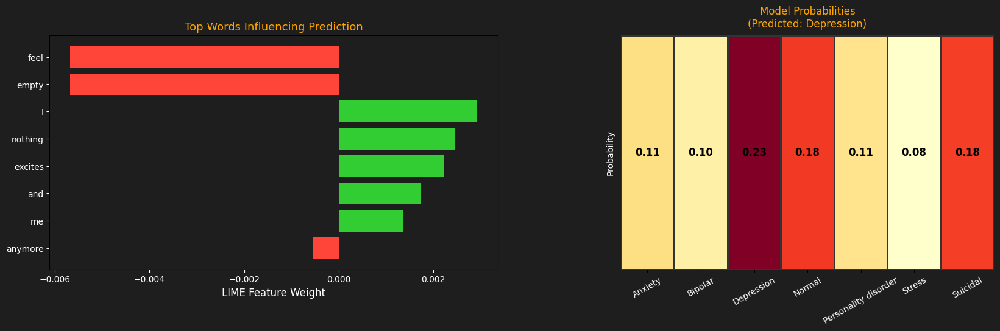

In [ ]:

!pip install transformers lime --quiet

import torch
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from lime.lime_text import LimeTextExplainer
from torch.nn.functional import softmax
import pickle
from IPython.display import HTML, display
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.gridspec as gridspec

# Load model and label encoder
model_path = "/content/drive/MyDrive/saved_mental_status_bert"
label_encoder_path = "/content/drive/MyDrive/label_encoder.pkl"

model = AutoModelForSequenceClassification.from_pretrained(model_path)
tokenizer = AutoTokenizer.from_pretrained(model_path)
label_encoder = pickle.load(open(label_encoder_path, 'rb'))
model.eval()

# Prediction function
def predict_proba_for_lime(texts, temperature=6.0, epsilon=1e-6):
    inputs = tokenizer(texts, return_tensors="pt", padding=True, truncation=True)
    with torch.no_grad():
        outputs = model(**inputs)
        logits = outputs.logits / temperature
        probs = softmax(logits, dim=1).cpu().numpy()
        probs = (probs + epsilon) / np.sum(probs + epsilon, axis=1, keepdims=True)
    return probs

# LIME explainer
explainer = LimeTextExplainer(class_names=label_encoder.classes_)

# Input text
sample_text = "I feel empty and nothing excites me anymore."


probs = predict_proba_for_lime([sample_text])[0]
pred_idx = np.argmax(probs)
predicted_class = label_encoder.classes_[pred_idx]


explanation = explainer.explain_instance(
    sample_text,
    predict_proba_for_lime,
    num_features=10,
    num_samples=1000
)


theme_colors = {
    "Depression":  ("#f28e2b", "😔 The model detects emotional exhaustion or sadness."),
    "Anxiety":     ("#6fc6c7", "😟 Signs of restlessness or worry."),
    "Suicidal":    ("#e74c3c", "🚨 Expressions of hopelessness detected."),
    "Bipolar":     ("#b565f5", "⚡ Mood or energy fluctuations noticed."),
    "Manic":       ("#f5b342", "🔥 High energy or racing thoughts detected."),
    "Normal":      ("#2ecc71", "🙂 Emotionally stable or neutral tone."),
    "Other":       ("#95a5a6", "💬 No strong emotional cues detected.")
}
theme_color, interpretation_text = theme_colors.get(predicted_class, ("#61dafb", "🤔 Emotional pattern unclear."))

# Header
header_html = f"""
<div style='background:#1e1e1e; padding:20px; border-radius:12px;
            box-shadow:0 0 20px rgba(255,255,255,0.1); font-family:Arial; color:white;'>
  <h2 style='text-align:center; color:{theme_color};'>💡 Model Interpretation</h2>
  <h3 style='text-align:center; color:#f5f5f5;'>Predicted Class:
      <b style='color:{theme_color}; font-size:22px;'>{predicted_class}</b>
  </h3>
  <p style='text-align:center; font-size:16px; color:#ddd;'>{interpretation_text}</p>
</div>
"""

# Highlighted words
def highlight_words(text, weights):
    tokens = text.split()
    html = "<div style='background:#222; color:white; padding:20px; border-radius:10px; font-family:Arial;'>"
    html += f"<h3 style='color:{theme_color};'>Text Highlights:</h3><p style='font-size:18px; line-height:1.8;'>"

    max_abs = max(abs(w) for _, w in weights)
    for tok in tokens:
        match = [w for w in weights if w[0].lower() in tok.lower()]
        if match:
            _, weight = match[0]
            intensity = min(abs(weight)/max_abs,1)
            color = f"rgba(50,205,50,{0.2 + 0.8*intensity})" if weight>0 else f"rgba(255,69,58,{0.2 + 0.8*intensity})"
            html += f"<span style='background-color:{color}; padding:3px 6px; border-radius:5px; margin:2px;'>{tok}</span> "
        else:
            html += tok + " "
    html += "</p></div>"
    return html

highlight_html = highlight_words(sample_text, explanation.as_list())

display(HTML(header_html + highlight_html))


weights = explanation.as_list()
words, vals = zip(*weights)
colors = ['#32CD32' if v>0 else '#FF453A' for v in vals]

# Increase figure width and adjust ratios
fig = plt.figure(figsize=(20,5))  # wider figure
gs = gridspec.GridSpec(1, 2, width_ratios=[1.2, 1], wspace=0.3)  # better space utilization

# Horizontal LIME weights
ax0 = fig.add_subplot(gs[0])
ax0.barh(words, vals, color=colors)
ax0.set_xlabel("LIME Feature Weight", fontsize=12, color='white')
ax0.set_title("Top Words Influencing Prediction", fontsize=13, color='orange')
ax0.invert_yaxis()
ax0.tick_params(axis='x', labelsize=10, colors='white')
ax0.tick_params(axis='y', labelsize=10, colors='white')
ax0.set_facecolor('#1e1e1e')

# Class probability heatmap
ax1 = fig.add_subplot(gs[1])
sns.heatmap(
    [probs],
    annot=True,
    fmt=".2f",
    cmap="YlOrRd",
    xticklabels=label_encoder.classes_,
    yticklabels=["Probability"],
    cbar=False,
    linewidths=1,
    linecolor="#333",
    annot_kws={"color":"black", "fontsize":12, "weight":"bold"},
    ax=ax1
)
ax1.set_title(f"Model Probabilities\n(Predicted: {predicted_class})", color='orange', fontsize=12, pad=10)
ax1.tick_params(axis='x', rotation=30, labelsize=10, labelcolor='white')
ax1.tick_params(axis='y', labelsize=10, labelcolor='white')
ax1.set_facecolor('#1e1e1e')

# Overall figure background
fig.patch.set_facecolor('#1e1e1e')
plt.show()



Evaluate model performance





🔄 Evaluating on test set... this may take a few minutes for 53k samples.



=== Classification Report ===
                      precision    recall  f1-score   support

             Anxiety       0.98      0.99      0.99       342
             Bipolar       0.99      1.00      1.00       397
          Depression       0.78      0.75      0.76       369
              Normal       0.92      0.94      0.93       401
Personality disorder       1.00      1.00      1.00       386
              Stress       0.95      1.00      0.98       361
            Suicidal       0.82      0.78      0.80       396

            accuracy                           0.92      2652
           macro avg       0.92      0.92      0.92      2652
        weighted avg       0.92      0.92      0.92      2652



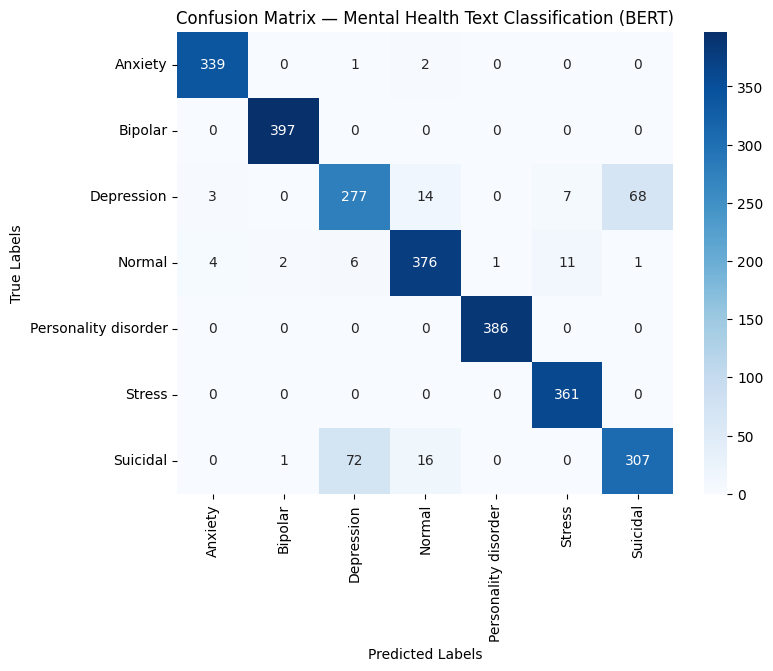

In [ ]:
from transformers import BertForSequenceClassification, BertTokenizer, Trainer, TrainingArguments
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import torch

#Load the model & tokenizer
model_path = "/content/drive/MyDrive/saved_mental_status_bert"
device = "cuda" if torch.cuda.is_available() else "cpu"
model = BertForSequenceClassification.from_pretrained(model_path).to(device)
tokenizer = BertTokenizer.from_pretrained(model_path)

# Define evaluation arguments
eval_args = TrainingArguments(
    output_dir="./results_eval",
    per_device_eval_batch_size=16,     # larger batch → faster (reduce if OOM)
    dataloader_num_workers=2,          # parallel loading
    report_to="none",                  # disable extra logs
)

# Create Trainer
trainer = Trainer(
    model=model,
    args=eval_args
)


print("🔄 Evaluating on test set... this may take a few minutes for 53k samples.")
predictions, labels, _ = trainer.predict(test_dataset)


predicted_labels = np.argmax(predictions, axis=1)

# 6️⃣ Print classification report
print("\n=== Classification Report ===")
print(classification_report(labels, predicted_labels, target_names=label_encoder.classes_))

# 7️⃣ Plot confusion matrix
cm = confusion_matrix(labels, predicted_labels)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=label_encoder.classes_,
            yticklabels=label_encoder.classes_)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix — Mental Health Text Classification (BERT)')
plt.show()


In [ ]:
!pip install transformers torch scikit-learn pandas tqdm seaborn --quiet

import pandas as pd
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, f1_score
from tqdm import tqdm
import seaborn as sns
import matplotlib.pyplot as pl

In [ ]:
model_path = "/content/drive/MyDrive/saved_mental_status_bert"  # ✅ your saved model path
tokenizer = AutoTokenizer.from_pretrained(model_path, local_files_only=True)
model = AutoModelForSequenceClassification.from_pretrained(model_path, local_files_only=True)


device = 'cuda' if torch.cuda.is_available() else 'cpu'
model.to(device)
model.eval()

BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e

In [ ]:
import pandas as pd

data = pd.read_csv("/content/reddit_depression_suicidewatch.csv")
data.dropna(inplace=True)

# Drop 'Unnamed: 0' only if it exists
if 'Unnamed: 0' in data.columns:
    data.drop(columns=['Unnamed: 0'], inplace=True)

print(data.head())
print(data.columns)


                                                text         label
0  I recently went through a breakup and she said...    depression
1  I do not know how to navigate these feelings, ...    depression
2  So I have been with my bf for 5 months , and h...    depression
3  I am so exhausted of this. Just when I think I...  SuicideWatch
4  I have been severly bullied since i was 5 till...    depression
Index(['text', 'label'], dtype='object')


In [ ]:
data=data.sample(n=6000, random_state=42).reset_index(drop=True)
data

,text,label
0,I was going to do it last night but I knew som...,SuicideWatch
1,Literally right after I posted how I always fu...,SuicideWatch
2,Recently a lot has been going on in my life. I...,depression
3,There is no long commentary hereJust know ever...,depression
4,I have called my crisis team but have to wait ...,SuicideWatch
...,...,...
5995,"I thought i had a plan but recently, I have be...",SuicideWatch
5996,Why? Just so you can enjoy watching me suffer?...,SuicideWatch
5997,The only thing i cared about was my dog. Now i...,depression
5998,"For a while, everythings been ideation- mostly...",SuicideWatch


In [ ]:
print(data.columns)


Index(['text', 'label'], dtype='object')


In [ ]:
import re
import nltk
from nltk.corpus import stopwords
nltk.download("stopwords")
stop_words = set(stopwords.words("english"))

def clean_statement(text):
  #lowercasing
  text = text.lower()
  #removing special characters or anything except letters
  text = re.sub(r'[^a-zA-Z\s]','', text)
  #tokenization (splitting)
  words = text.split()
  words = [word for word in words if word not in stop_words]
  return " ".join(words)
data['text'] = data['text'].apply(clean_statement)

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
data['label'].value_counts()

,count
label,
depression,3043
SuicideWatch,2957


In [ ]:
from imblearn.over_sampling import RandomOverSampler

ros = RandomOverSampler(sampling_strategy = 'auto', random_state=42)

X= data.drop('label', axis=1)
y=data['label']
X_resampled, y_resampled = ros.fit_resample(X,y)

data = pd.concat([X_resampled, y_resampled], axis=1)

print(data['label'].value_counts())

label
SuicideWatch    3043
depression      3043
Name: count, dtype: int64


In [ ]:
# Create a consistent label mapping
mapping = {
    'depression': 2,
    'SuicideWatch': 6
}

# If your dataset column is 'subreddit'
data['label'] = data['label'].map(mapping)


In [ ]:
print(data[['text', 'label']].head())
print(data['label'].value_counts())


                                                text  label
0  going last night knew someone family might com...      6
1  literally right posted always fuck keep pushin...      6
2  recently lot going life gained new mental diso...      2
3  long commentary herejust know everything longe...      2
4  called crisis team wait call back bpd lowest p...      6
label
6    3043
2    3043
Name: count, dtype: int64


In [ ]:
def predict_label(text):
    inputs = tokenizer(
        text,
        return_tensors='pt',
        truncation=True,
        padding=True,
        max_length=128
    ).to(device)

    with torch.no_grad():
        logits = model(**inputs).logits
        pred = torch.argmax(logits, dim=-1).cpu().item()
    return pred

# ============================================
# 🧠 5️⃣ Generate predictions
# ============================================
predictions = []
for text in tqdm(data['text'], desc="Predicting"):
    predictions.append(predict_label(text))

data['pred_label'] = predictions


Predicting: 100%|██████████| 6086/6086 [01:50<00:00, 55.32it/s] 


In [ ]:
y_true = data['label'].astype(int)
y_pred = data['pred_label'].astype(int)

print("\n🧾 Classification Report (Depression vs Suicidal):\n")
print(classification_report(y_true, y_pred, labels=[2, 6], target_names=['depression', 'suicidal']))

accuracy = accuracy_score(y_true, y_pred)
print(f"\n✅ Overall Accuracy: {accuracy * 100:.2f}%")


🧾 Classification Report (Depression vs Suicidal):

              precision    recall  f1-score   support

  depression       0.72      0.71      0.72      3043
    suicidal       0.73      0.68      0.70      3043

   micro avg       0.73      0.70      0.71      6086
   macro avg       0.73      0.70      0.71      6086
weighted avg       0.73      0.70      0.71      6086


✅ Overall Accuracy: 69.77%


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

# Keep only rows where true_label is 2 or 6
filtered_data = data[data['label'].isin([2, 6])].copy()

# Compute overall accuracy
print("\nOverall Accuracy:",
      accuracy_score(filtered_data['label'], filtered_data['pred_label']))

# Classification report only for these 2 classes
print("\nClassification Report:")
print(classification_report(
    filtered_data['label'],
    filtered_data['pred_label'],
    labels=[2, 6],                     # only evaluate 2 and 6
    target_names=['depression', 'suicidal']
))

# Optional: Confusion matrix
print("\nConfusion Matrix:")
print(confusion_matrix(filtered_data['label'], filtered_data['pred_label'], labels=[2,6]))



Overall Accuracy: 0.6976667762076898

Classification Report:
              precision    recall  f1-score   support

  depression       0.72      0.71      0.72      3043
    suicidal       0.73      0.68      0.70      3043

   micro avg       0.73      0.70      0.71      6086
   macro avg       0.73      0.70      0.71      6086
weighted avg       0.73      0.70      0.71      6086


Confusion Matrix:
[[2174  770]
 [ 825 2072]]


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import numpy as np
import pandas as pd

# Keep only depression (2) and suicidal (6)
filtered_data = data[data['label'].isin([2, 6])].copy()

# Compute predictions & overall accuracy
overall_acc = accuracy_score(filtered_data['label'], filtered_data['pred_label'])
print(f"\n✅ Overall Accuracy: {overall_acc*100:.2f}%")


# Calculate per-class accuracy manually
class_names = ['depression', 'suicidal']
per_class_acc = {}

for i, cls in enumerate(class_names):
    TP = cm[i, i]
    FN = cm[i, :].sum() - TP
    FP = cm[:, i].sum() - TP
    TN = cm.sum() - (TP + FP + FN)
    acc = (TP + TN) / cm.sum()
    per_class_acc[cls] = acc

print("\n🎯 Per-Class Accuracy:")
for cls, acc in per_class_acc.items():
    print(f"{cls}: {acc*100:.2f}%")



✅ Overall Accuracy: 69.77%

🎯 Per-Class Accuracy:
depression: 72.69%
suicidal: 72.69%
